In [1]:
import pandas as pd
import numpy as np
import math

import scipy.stats as stats
import matplotlib.pyplot as plt
import seaborn as sns

import random

from pymongo import MongoClient
import squic

In [2]:
# Set connection
client = MongoClient("mongodb://localhost:27017/")
db = client["bank"]
balances_collection = db["balances"]

In [3]:
# Fetch balance evolution data from MongoDB
cursor = balances_collection.find({}, {"_id": 0})  # Exclude MongoDB item ID

balances = list(cursor)
balances

[{'date': '2017-01-01',
  'balances': {'0': {'balance': 58433.82},
   '1': {'balance': 99157.07},
   '2': {'balance': 98998.0},
   '3': {'balance': 73402.12},
   '4': {'balance': 93303.34},
   '5': {'balance': 89628.77},
   '6': {'balance': 98873.57},
   '7': {'balance': 96397.99},
   '8': {'balance': 81350.33},
   '9': {'balance': 98184.5},
   '10': {'balance': 96821.61},
   '11': {'balance': 103423.23},
   '12': {'balance': 93311.28},
   '13': {'balance': 60493.41},
   '14': {'balance': 58053.96},
   '15': {'balance': 52090.69},
   '16': {'balance': 95618.22},
   '17': {'balance': 66731.39},
   '18': {'balance': 85272.36},
   '19': {'balance': 83742.63},
   '20': {'balance': 59528.84},
   '21': {'balance': 77456.3},
   '22': {'balance': 54873.42},
   '23': {'balance': 74131.99},
   '24': {'balance': 64435.66},
   '25': {'balance': 56932.93},
   '26': {'balance': 99088.45},
   '27': {'balance': 70060.79},
   '28': {'balance': 62022.29},
   '29': {'balance': 61862.43},
   '30': {'balan

In [4]:
#df = pd.DataFrame([{**entry["balances"], "date": entry["date"]} for entry in data])

#print(df.shape) # must be (720, 1447)
#print(df.head())

#      | id1 | id2 | ... | id1446
# day1 |   
# day2 |        balances
# ...

In [5]:
#df

In [6]:
# Check the number of unique dates in extracted data
dates = [entry["date"] for entry in balances]
print("Unique dates found:", len(set(dates)))  # Should be 720
print("First 5 dates:", sorted(set(dates))[:5])
print("Last 5 dates:", sorted(set(dates))[-5:])

Unique dates found: 720
First 5 dates: ['2017-01-01', '2017-01-02', '2017-01-03', '2017-01-04', '2017-01-05']
Last 5 dates: ['2018-12-17', '2018-12-18', '2018-12-19', '2018-12-20', '2018-12-21']


In [7]:
df = pd.DataFrame([
    {key: value["balance"] for key, value in entry["balances"].items()} | {"date": entry["date"]}
    for entry in balances
])

# Convert "date" to datetime and set as index
df["date"] = pd.to_datetime(df["date"])
df.set_index("date", inplace=True)
df.sort_index(inplace=True)

In [8]:
df

,0,1,2,3,4,5,6,7,8,9,...,8022,8023,8024,8025,8026,8027,8028,8029,8030,8031
date,,,,,,,,,,,,,,,,,,,,,
2017-01-01,58433.82,99157.07,98998.00,73402.12,93303.34,89628.77,98873.57,96397.99,81350.33,98184.50,...,88071.61,88415.63,67821.12,85240.72,50734.42,92468.31,64446.52,83800.92,65582.11,77376.45
2017-01-02,58433.82,101158.16,99858.66,74546.84,93357.41,91736.73,100899.82,97980.47,84010.85,100669.69,...,88071.61,88415.63,67821.12,85240.72,50734.42,92468.31,64446.52,83800.92,65582.11,77376.45
2017-01-03,58433.82,101525.80,99336.37,74822.13,93172.66,93337.83,102056.73,99937.33,84791.74,101820.06,...,88071.61,88415.63,67821.12,85240.72,50734.42,92468.31,64446.52,83800.92,65582.11,77376.45
2017-01-04,58433.82,100740.16,99442.69,74822.13,95056.70,93337.83,103430.20,99937.33,85222.04,105957.96,...,88071.61,88415.63,67821.12,85240.72,50734.42,92468.31,64446.52,83800.92,65582.11,77650.14
2017-01-05,58433.82,101343.39,99442.69,75119.55,96768.95,93802.87,103430.20,101423.34,85589.89,109003.18,...,88071.61,88415.63,67821.12,85240.72,50734.42,92468.31,64446.52,83800.92,65582.11,77650.14
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2018-12-17,60537.03,218959.32,92084.67,259252.70,358863.12,602751.96,605788.28,526356.93,839757.17,1087918.97,...,88071.61,88415.63,68682.21,88113.18,52518.65,93062.82,64446.52,86204.46,66888.72,117801.56
2018-12-18,60537.03,218959.32,91559.22,259252.70,357980.37,603072.44,606620.08,526250.98,841249.28,1087728.08,...,88071.61,88415.63,68682.21,88113.18,52518.65,93062.82,64446.52,86204.46,66888.72,117801.56
2018-12-19,60537.03,218246.13,90783.54,259252.70,358342.85,603072.44,607002.15,526250.98,841732.91,1087082.23,...,88071.61,88415.63,68682.21,88113.18,52518.65,93062.82,64446.52,86204.46,66888.72,117801.56


In [9]:
df['0']

date
2017-01-01    58433.82
2017-01-02    58433.82
2017-01-03    58433.82
2017-01-04    58433.82
2017-01-05    58433.82
                ...   
2018-12-17    60537.03
2018-12-18    60537.03
2018-12-19    60537.03
2018-12-20    60537.03
2018-12-21    60537.03
Name: 0, Length: 720, dtype: float64

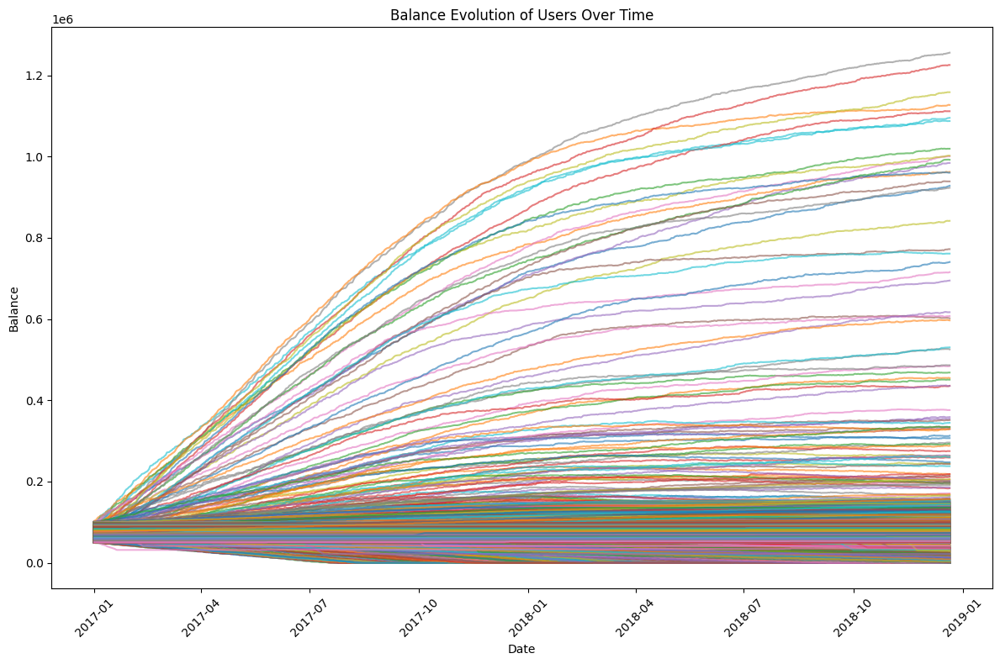

In [10]:
# Plot the balance evolution for all users (columns) as separate lines
plt.figure(figsize=(12, 8))

# Plot each column (account balance) as a line
for user in df.columns:
    plt.plot(df.index, df[user], label=f"User {user}", alpha=0.6)

# Add title and labels
plt.title("Balance Evolution of Users Over Time")
plt.xlabel("Date")
plt.ylabel("Balance")

# Rotate x-axis labels for better visibility
plt.xticks(rotation=45)

# Add legend to differentiate users
# plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')

# Display the plot
plt.tight_layout()
plt.show()

# Balance Distribution

### First and last day

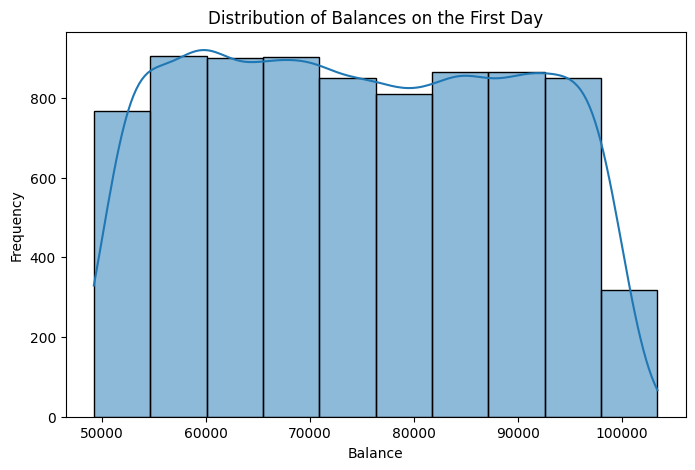

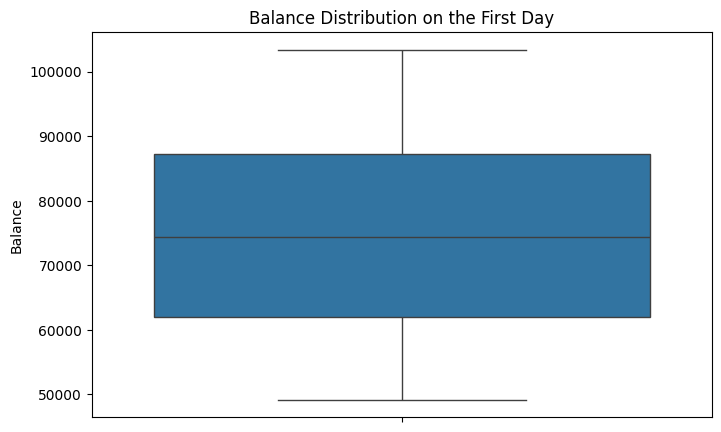

In [11]:
# Select the balances on the first day
first_day_balances = df.iloc[0]

# Plot histogram
plt.figure(figsize=(8, 5))
sns.histplot(first_day_balances, bins=10, kde=True)
plt.xlabel("Balance")
plt.ylabel("Frequency")
plt.title("Distribution of Balances on the First Day")
plt.show()

# Plot box plot
plt.figure(figsize=(8, 5))
sns.boxplot(y=first_day_balances)
plt.ylabel("Balance")
plt.title("Balance Distribution on the First Day")
plt.show()

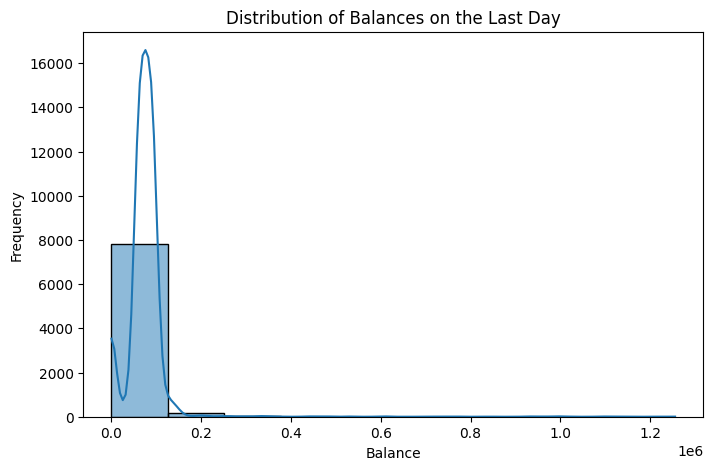

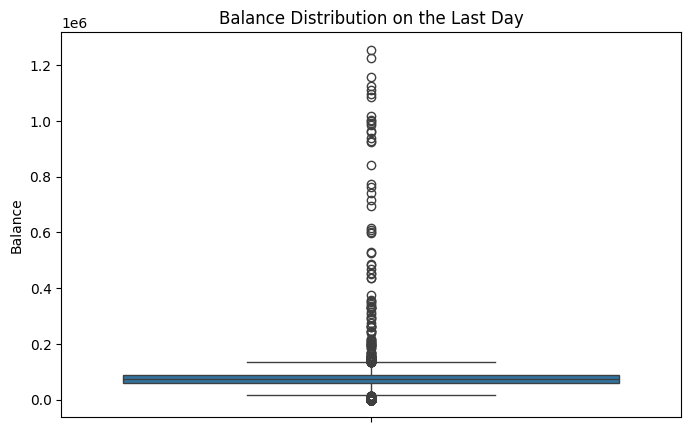

In [12]:
# Select the balances on the first day
last_day_balances = df.iloc[-1]

# Plot histogram
plt.figure(figsize=(8, 5))
sns.histplot(last_day_balances, bins=10, kde=True)
plt.xlabel("Balance")
plt.ylabel("Frequency")
plt.title("Distribution of Balances on the Last Day")
plt.show()

# Plot box plot
plt.figure(figsize=(8, 5))
sns.boxplot(y=last_day_balances)
plt.ylabel("Balance")
plt.title("Balance Distribution on the Last Day")
plt.show()

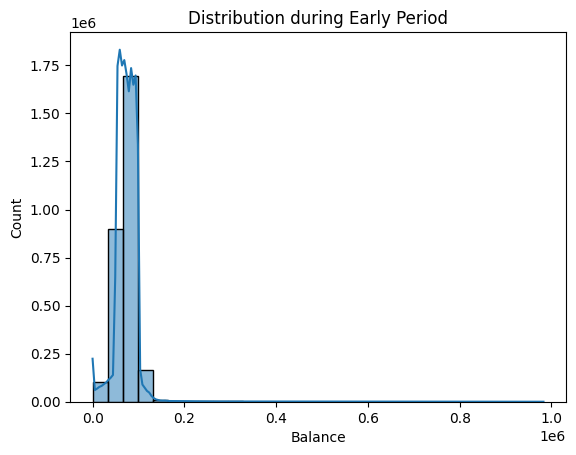

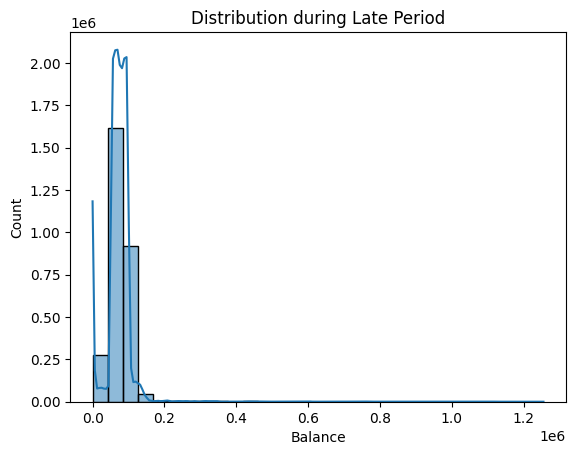

In [13]:
# Split the DataFrame into two parts
early_period = df.iloc[:int(0.5 * len(df))]
late_period  = df.iloc[int(0.5 * len(df)):]

# Plot distribution for early days (aggregated over users and days)
sns.histplot(early_period.values.flatten(), bins=30, kde=True)
plt.title("Distribution during Early Period")
plt.xlabel("Balance")
plt.show()

# Plot distribution for late days
sns.histplot(late_period.values.flatten(), bins=30, kde=True)
plt.title("Distribution during Late Period")
plt.xlabel("Balance")
plt.show()

### Total Distribution

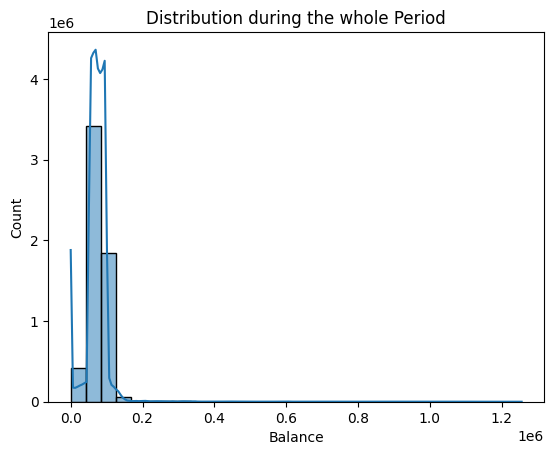

In [14]:
values_df = df.values.flatten()
# Plot distribution for all the days (aggregated over users and days)
sns.histplot(values_df, bins=30, kde=True)
plt.title("Distribution during the whole Period")
plt.xlabel("Balance")
plt.show()

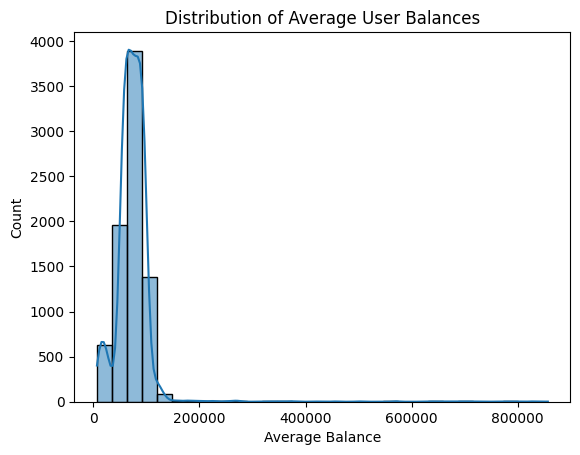

In [15]:
# Compute the mean balance per user over all days
user_means = df.mean(axis=0)

sns.histplot(user_means, bins=30, kde=True)
plt.title("Distribution of Average User Balances")
plt.xlabel("Average Balance")
plt.show()

# Techniques

## CLT

In [16]:
random_users = []

total_account = len(df.columns)

print(f"Total accounts: {total_account}")
random.seed(77)  # Fixes randomness for consistent results

for _ in range(8000):
    new = False
    while new == False:
        user = random.randint(0, total_account - 1)
        if user not in random_users:
            new = True
            random_users.append(user)

print(f"Number of extracted random accounts: {len(random_users)}")

Total accounts: 8032
Number of extracted random accounts: 8000


In [17]:
days = len(balances) # num of days
weeks = len(balances)//7 # num of weeks
rest = len(balances)%7 # remaining days

In [18]:
clt_distribution = []

# in order to appy CLT -> every week take the mean of the selected users' balances
for i in range(weeks):
    week_data = []
    week_balances = df.iloc[i*7]
    # print(week_balances.name)

    for user in random_users:
    # for user in range(len(df.columns)): -> se prendo tutti gli utenti
        # print(user)
        # print(week_balances[user])
        week_data.append(week_balances[user])
    
    mean = np.mean(week_data)
    clt_distribution.append(round(mean, 2))

/var/folders/s6/4jprwbqj4012tkll2ww6r5hr0000gq/T/ipykernel_6107/536784648.py:13: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  week_data.append(week_balances[user])


In [19]:
clt_distribution = [float(np_float) for np_float in clt_distribution]
clt_distribution

[74689.62,
 74689.8,
 74689.98,
 74690.16,
 74690.24,
 74690.44,
 74690.66,
 74690.74,
 74690.83,
 74691.02,
 74691.2,
 74691.2,
 74691.4,
 74691.58,
 74691.58,
 74691.7,
 74691.81,
 74691.97,
 74691.86,
 74691.98,
 74692.04,
 74691.93,
 74691.89,
 74691.99,
 74692.11,
 74692.01,
 74692.12,
 74692.15,
 74691.99,
 74692.09,
 74692.18,
 74692.24,
 74692.32,
 74692.4,
 74692.4,
 74692.58,
 74692.7,
 74692.86,
 74692.94,
 74693.04,
 74693.24,
 74693.28,
 74693.46,
 74693.63,
 74693.78,
 74693.91,
 74693.9,
 74694.08,
 74694.28,
 74694.48,
 74694.53,
 74694.73,
 74694.87,
 74695.02,
 74695.1,
 74695.26,
 74695.23,
 74695.27,
 74695.39,
 74695.62,
 74695.45,
 74695.42,
 74695.4,
 74695.12,
 74694.95,
 74694.84,
 74694.61,
 74694.6,
 74694.53,
 74694.41,
 74694.37,
 74694.29,
 74694.25,
 74694.15,
 74694.1,
 74693.83,
 74693.71,
 74693.67,
 74693.66,
 74693.61,
 74693.52,
 74693.49,
 74693.43,
 74693.38,
 74693.3,
 74693.02,
 74692.85,
 74692.68,
 74692.64,
 74692.61,
 74692.58,
 74692.54,
 7

<function matplotlib.pyplot.show(close=None, block=None)>

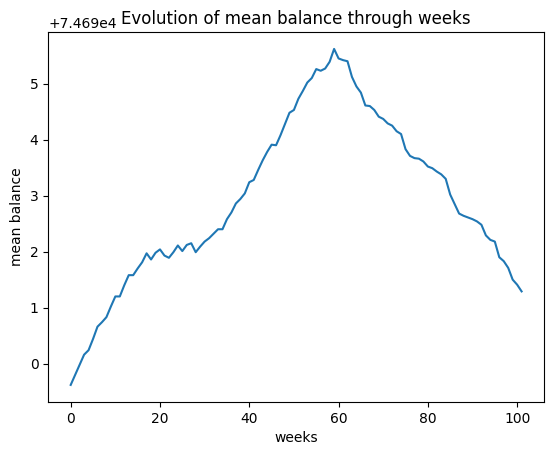

In [20]:
plt.plot(range(weeks), clt_distribution)
plt.xlabel("weeks")
plt.ylabel("mean balance")
plt.title("Evolution of mean balance through weeks")
plt.show

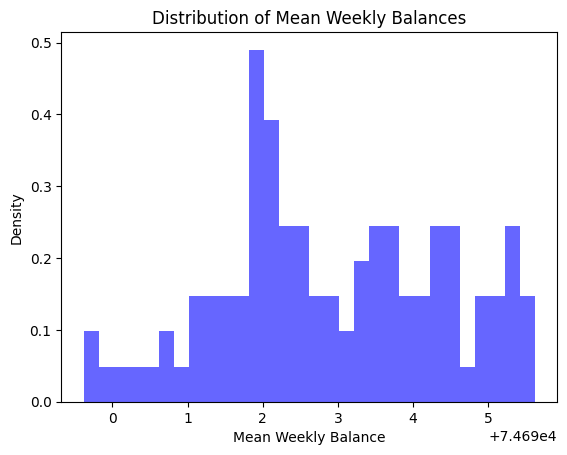

In [21]:
# Histogram to visually inspect the shape of the distribution of the mean balance during weeks
# X axis -> offset +7.469e4 from 74.690 to 74.696
plt.hist(clt_distribution, bins=30, density=True, alpha=0.6, color='b')
plt.xlabel("Mean Weekly Balance")
plt.ylabel("Density")
plt.title("Distribution of Mean Weekly Balances")
plt.show()


In [22]:
# If p > 0.05, the data is likely normally distributed
# If stat -> 1 the data is likely normally distributed
def ks_test(distribution):
    mu = np.mean(distribution)
    std = np.std(distribution)
    ks_stat, ks_p = stats.kstest(distribution, 'norm', args=(mu, std))

    print(f"K-S Test: Statistic={ks_stat:.4f}, p-value={ks_p:.4g}")

    if ks_p < 0.05:
        print("Data is likely NOT normal.")
    else:
        print("Data is likely normal.")

In [23]:
# Normality test
ks_test(clt_distribution)

K-S Test: Statistic=0.0719, p-value=0.6407
Data is likely normal.


now that CLT seems to have a normal distribution, I use clt_distribution array to compute the mean and std dev in order to generate new synthetic data

In [24]:
clt_mean = np.mean(clt_distribution)
clt_std = np.std(clt_distribution)

# Generate synthetic data using the CLT mean & std
clt_synthetic_data = np.random.normal(loc=clt_mean, scale=clt_std, size=(days, total_account))

# Convert to DataFrame
df_clt = pd.DataFrame(clt_synthetic_data)

In [25]:
values_df_clt = df_clt.values.flatten()

ks_test(values_df_clt)

K-S Test: Statistic=0.0002, p-value=0.8968
Data is likely normal.


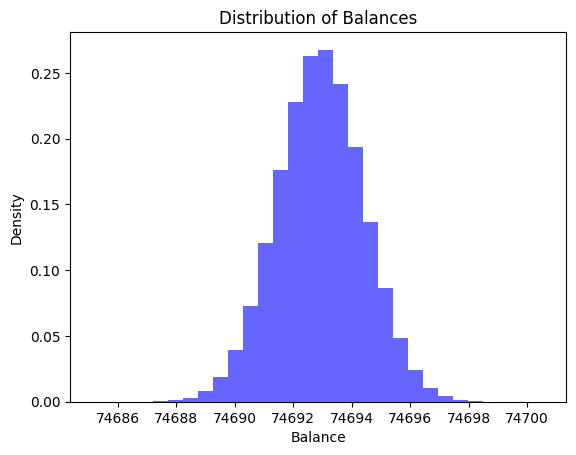

In [26]:
plt.hist(values_df_clt, bins=30, density=True, alpha=0.6, color='b')
plt.xlabel("Balance")
plt.ylabel("Density")
plt.title("Distribution of Balances")
plt.show()

In [27]:
df_clt

,0,1,2,3,4,5,6,7,8,9,...,8022,8023,8024,8025,8026,8027,8028,8029,8030,8031
0,74691.650245,74690.030045,74693.615055,74692.212087,74691.667531,74689.610451,74694.447704,74691.689504,74690.810169,74692.330917,...,74692.692887,74692.547191,74691.214272,74693.452129,74690.750411,74693.150765,74695.624857,74692.875903,74695.101420,74690.137128
1,74692.157240,74693.018557,74690.859283,74693.211729,74694.321562,74692.814414,74691.107656,74695.076327,74693.505480,74695.580908,...,74693.832140,74693.705986,74693.091182,74691.568136,74692.033401,74689.422657,74692.894835,74695.008164,74693.362825,74692.931707
2,74692.295499,74691.752305,74693.291334,74694.404656,74691.274141,74693.324015,74691.763812,74693.674146,74693.308981,74695.023051,...,74691.852968,74692.897523,74692.284771,74691.403672,74693.506364,74693.468858,74693.572856,74693.673267,74691.721575,74692.758987
3,74692.924511,74694.725255,74695.061288,74692.491503,74692.064585,74692.450701,74693.620862,74693.050857,74690.985931,74690.961713,...,74689.158305,74694.132815,74691.963996,74693.457980,74694.478247,74694.142047,74692.696695,74693.122127,74693.388762,74692.828301
4,74694.158807,74694.995110,74693.088148,74692.732586,74693.532274,74691.741185,74692.684827,74693.568520,74693.411500,74694.041250,...,74690.473948,74692.951235,74691.683425,74692.303372,74695.265401,74692.442713,74692.421923,74694.485697,74693.738610,74694.178317
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
715,74693.267138,74692.842020,74691.853873,74693.856280,74695.097933,74693.615350,74694.179973,74693.398510,74692.495910,74692.897458,...,74689.949146,74689.562826,74694.965700,74693.271266,74693.369279,74690.125072,74693.625476,74691.822597,74694.620937,74691.270441
716,74694.387112,74691.553169,74692.435158,74692.774411,74694.047770,74693.113720,74692.382481,74691.572262,74690.233221,74690.979028,...,74693.198951,74693.940233,74692.952653,74693.920029,74691.398565,74691.601524,74693.659317,74692.146747,74692.088186,74693.923882
717,74695.066320,74692.836179,74693.777548,74693.368937,74692.447725,74694.997654,74693.161489,74694.683536,74695.068506,74690.592947,...,74692.653613,74694.428539,74690.141978,74693.570795,74694.482665,74693.316097,74692.610772,74692.912858,74691.973760,74692.817997
718,74693.491173,74693.207296,74692.067939,74694.256070,74691.611950,74691.441395,74692.432661,74690.254764,74691.246117,74694.298350,...,74693.390929,74694.312846,74692.602576,74687.817078,74692.142460,74694.081022,74694.405420,74692.103629,74691.467815,74692.626865


## Log

In [28]:
df_log = df.copy()
df_log = df_log.applymap(math.log)

/var/folders/s6/4jprwbqj4012tkll2ww6r5hr0000gq/T/ipykernel_6107/2815163777.py:2: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  df_log = df_log.applymap(math.log)


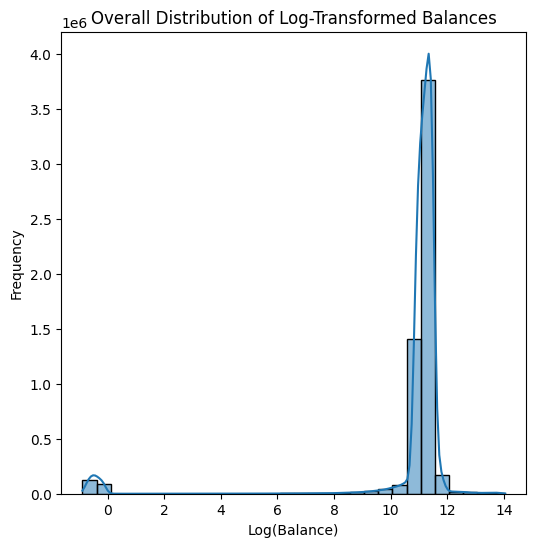

In [29]:
# Flatten the DataFrame values into a single array
values_df_log = df_log.values.flatten()

plt.figure(figsize=(6, 6))
sns.histplot(values_df_log, kde=True, bins=30, edgecolor='black')
plt.title("Overall Distribution of Log-Transformed Balances")
plt.xlabel("Log(Balance)")
plt.ylabel("Frequency")
plt.show()

In [30]:
# mu, std = values_df_log.mean(), values_df_log.std()
ks_test(values_df_log)

K-S Test: Statistic=0.4336, p-value=0
Data is likely NOT normal.


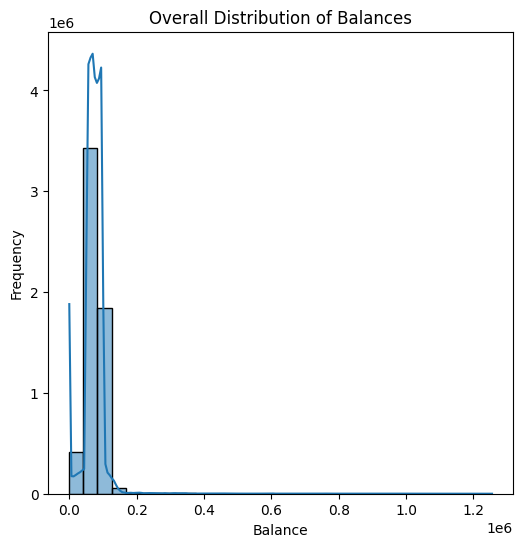

In [31]:
plt.figure(figsize=(6, 6))
sns.histplot(values_df, kde=True, bins=30, edgecolor='black')
plt.title("Overall Distribution of Balances")
plt.xlabel("Balance")
plt.ylabel("Frequency")
plt.show()

## Wold

In [32]:
# Difference with previous row
df_w = df.diff().dropna()  # drop the first row which will be NaN

values_df_w = df_w.values.flatten()

# Remove NaN values (from the first differencing step)
values_df_w = values_df_w[~np.isnan(values_df_w)]


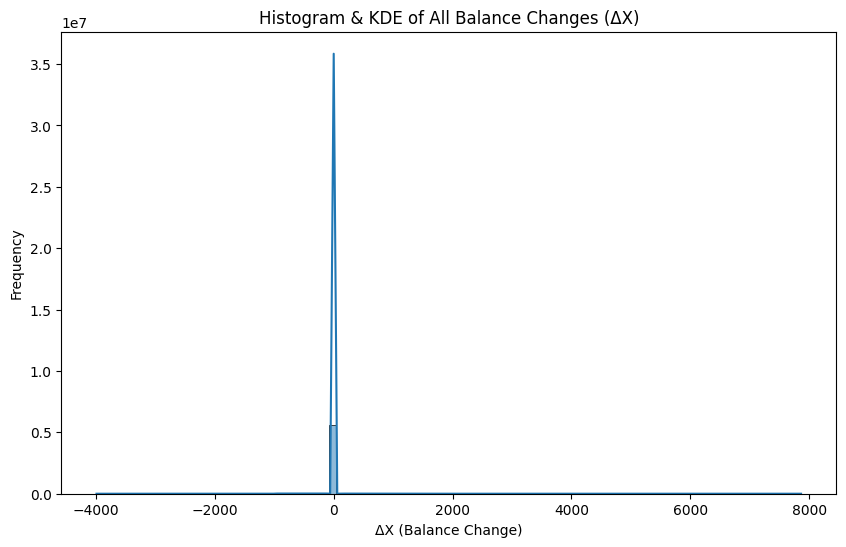

In [33]:
plt.figure(figsize=(10, 6))
sns.histplot(values_df_w, kde=True, bins=100, edgecolor='black')
plt.title("Histogram & KDE of All Balance Changes (ΔX)")
plt.xlabel("ΔX (Balance Change)")
plt.ylabel("Frequency")
plt.show()

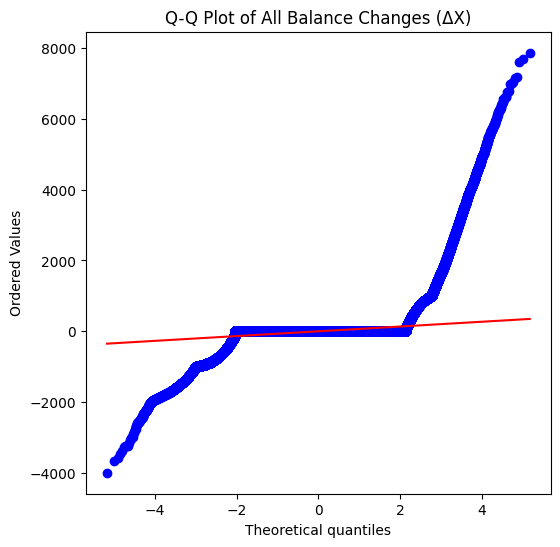

In [34]:
plt.figure(figsize=(6, 6))
stats.probplot(values_df_w, dist="norm", plot=plt)
plt.title("Q-Q Plot of All Balance Changes (ΔX)")
plt.show()

In [35]:
ks_test(values_df_w)

K-S Test: Statistic=0.4837, p-value=0
Data is likely NOT normal.


## Geometric brownian

In [36]:
df_gmb = np.log(df / df.shift(1)) # Compute r_t = log(X_t / X_{t-1}) for each user
df_gmb = df_gmb.dropna()  # Remove the first row which will be NaN

# Flatten the DataFrame into a 1D array
values_df_gmb = df_gmb.values.flatten()

# Remove any potential NaN values
values_df_gmb = values_df_gmb[~np.isnan(values_df_gmb)]

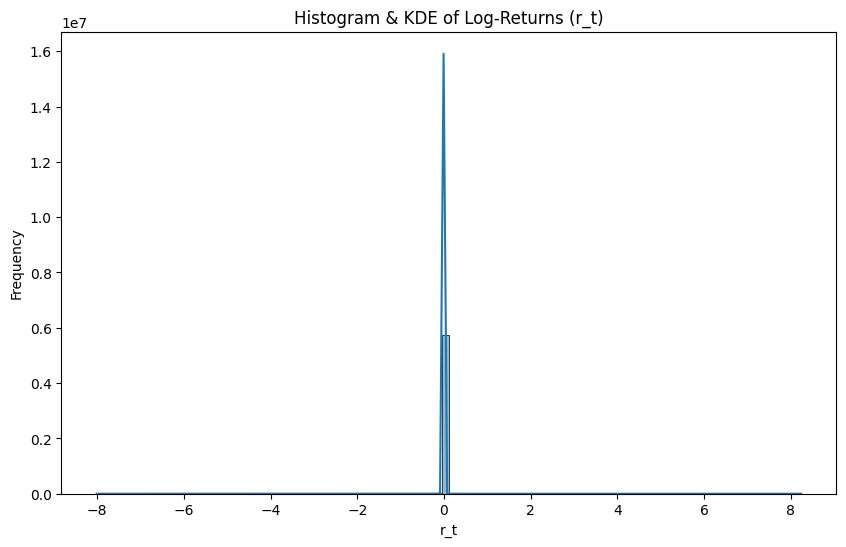

In [37]:
plt.figure(figsize=(10, 6))
sns.histplot(values_df_gmb, kde=True, bins=100, edgecolor='black')
plt.title("Histogram & KDE of Log-Returns (r_t)")
plt.xlabel("r_t")
plt.ylabel("Frequency")
plt.show()

Big Peak Around 0: most of the log returns are very close to zero. This indicates that on a day-to-day basis, most changes in the users' balances are small. In other words, the system is quite stable on most days.

The presence of long tails (leptokurtic distributions) on both sides means that there are relatively rare, but significant, movements. These tails suggest that there are occasional days with very large negative or positive returns.

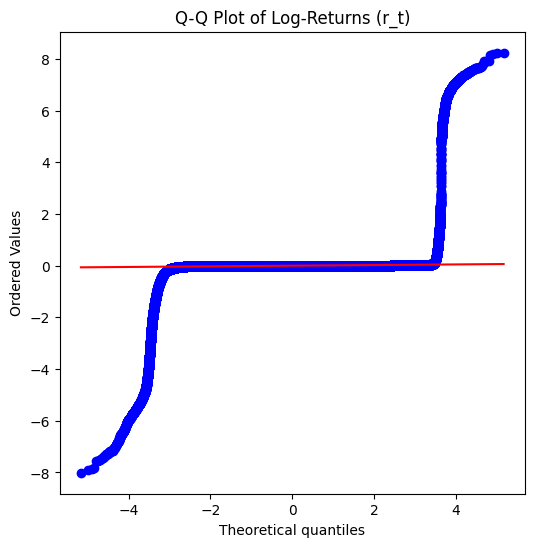

In [38]:
plt.figure(figsize=(6, 6))
stats.probplot(values_df_gmb, dist="norm", plot=plt)
plt.title("Q-Q Plot of Log-Returns (r_t)")
plt.show()

In [39]:
ks_test(values_df_gmb)

K-S Test: Statistic=0.4830, p-value=0
Data is likely NOT normal.


if are not normal standardize

In [40]:
# Standardize the log-returns for each user
df_gmb_std = (df_gmb - df_gmb.mean()) / df_gmb.std()

values_df_gmb_std = df_gmb_std.values.flatten()
values_df_gmb_std = values_df_gmb_std[~np.isnan(values_df_gmb_std)]

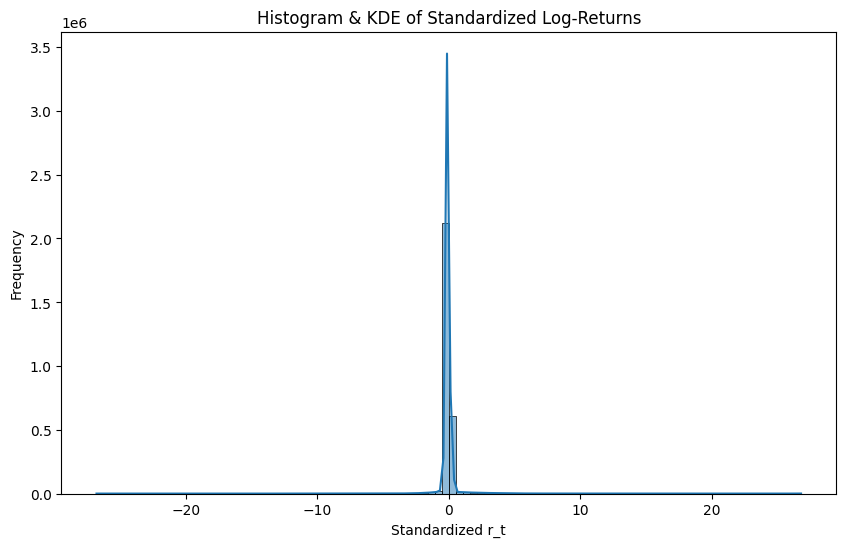

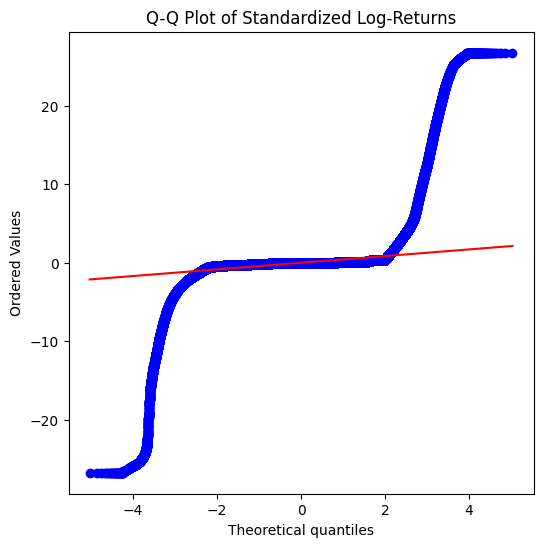

In [41]:
# Histogram for standardized returns
plt.figure(figsize=(10, 6))
sns.histplot(values_df_gmb_std, kde=True, bins=100, edgecolor='black')
plt.title("Histogram & KDE of Standardized Log-Returns")
plt.xlabel("Standardized r_t")
plt.ylabel("Frequency")
plt.show()

# Q-Q plot for standardized returns
plt.figure(figsize=(6, 6))
stats.probplot(values_df_gmb_std, dist="norm", plot=plt)
plt.title("Q-Q Plot of Standardized Log-Returns")
plt.show()

In [42]:
ks_test(values_df_gmb_std)

K-S Test: Statistic=0.3947, p-value=0
Data is likely NOT normal.


# Squic

In [43]:
def compute_squic(df, l):
    Y = df.to_numpy()

    [X,W,info_times,info_objective,info_logdetX,info_trSX] = squic.run(Y,l)

    print(X.todense())
    return X

def count_zero(X):
    # Count nonzero elements in X
    num_nonzero = X.nnz

    # Compute sparsity level
    total_elements = X.shape[0] * X.shape[1]
    sparsity = num_nonzero / total_elements

    print(f"Number of nonzero elements: {num_nonzero}")
    print(f"Sparsity level: {sparsity:.4f}")

def sparsity_pattern(X):
    plt.figure(figsize=(10, 10))
    plt.spy(X, markersize=5)  # Adjust markersize for better visibility
    plt.title("Sparsity Pattern of Precision Matrix (X)")
    plt.show()

In [44]:
l = 1e-3

## Squic DF

In [ ]:
# X_df = compute_squic(df, l)

In [ ]:
# count_zero(X_df)

In [ ]:
# sparsity_pattern(X_df)

matrix is dense, almost every variable is conditionally dependent on most others.

$\lambda$ used in the ℓ₁-regularization is too small. A lower $\lambda$ applies less penalty on nonzero elements, leading to fewer entries being forced to zero.

## Squic CLT

In [48]:
X_clt = compute_squic(df_clt, 0.4) # way more dense with 1e-3

----------------------------------------------------------------
                     SQUIC Version 1.0                         
----------------------------------------------------------------
Input Matrices
 nnz(X0)/p:   1.000000e+00
 nnz(W0)/p:   1.000000e+00
 nnz(M)/p:    ignored
 Y:           720 x 8032 
Runtime Configs   
 Sample Cov.:   Deterministic
 CordDec Vers:  Collective coordinate descent update 
 Inversion:     Approx. block Neumann series
 Fact. Routine: CHOLMOD
Parameters       
 verbose:     1 
 lambda:      4.000000e-01 
 max_iter:    100 
 term_tol:    1.000000e-03 
 inv_tol:     1.000000e-04 
 threads:     12 

#SQUIC Started 
* sample covariance matrix S: time=4.51e-02 nnz(S)/p=1.00e+00
* iter=1 time=2.03e-03 obj=1.42e+03 |delta(obj)|/obj=9.67e-02 nnz(X,L,W)/p=[1.00e+00 5.00e-01 1.00e+00] lns_iter=2 
* iter=2 time=2.44e-03 obj=1.40e+03 |delta(obj)|/obj=1.57e-02 nnz(X,L,W)/p=[1.00e+00 5.00e-01 1.00e+00] lns_iter=1 
* iter=3 time=2.87e-03 obj=1.40e+03 |delta(obj)|/o

In [49]:
count_zero(X_clt)

Number of nonzero elements: 720
Sparsity level: 0.0014


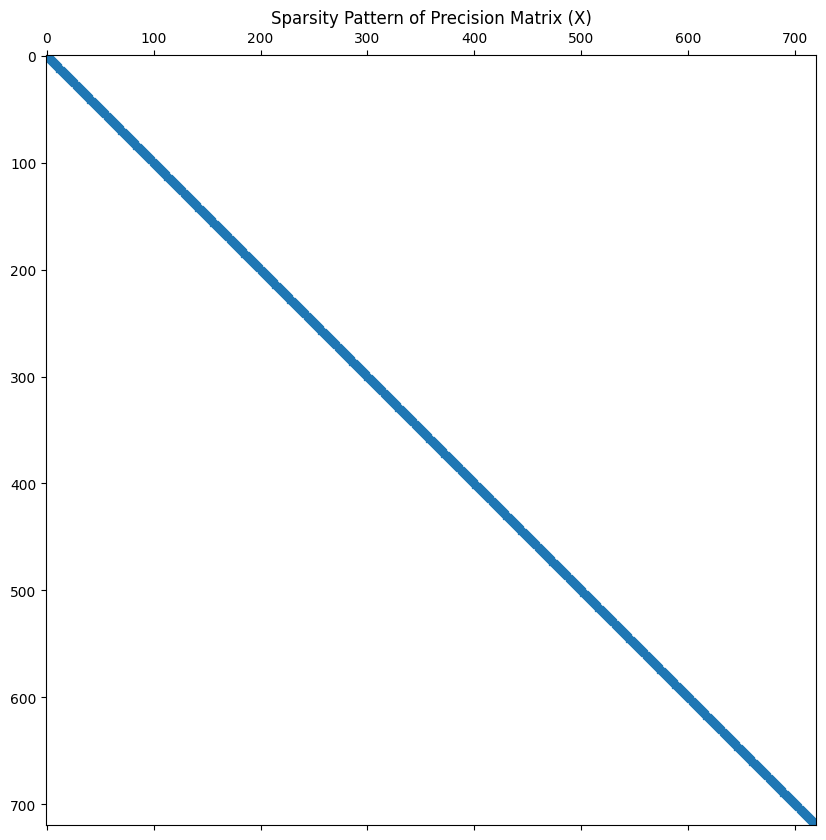

In [50]:
sparsity_pattern(X_clt)

## Squic Log

In [51]:
# X_log = compute_squic(df_log, l)

In [52]:
# count_zero(X_log)

In [53]:
# sparsity_pattern(X_log)

## Squic Wold

In [54]:
X_w = compute_squic(df_w, l)

----------------------------------------------------------------
                     SQUIC Version 1.0                         
----------------------------------------------------------------
Input Matrices
 nnz(X0)/p:   1.000000e+00
 nnz(W0)/p:   1.000000e+00
 nnz(M)/p:    ignored
 Y:           719 x 8032 
Runtime Configs   
 Sample Cov.:   Deterministic
 CordDec Vers:  Collective coordinate descent update 
 Inversion:     Approx. block Neumann series
 Fact. Routine: CHOLMOD
Parameters       
 verbose:     1 
 lambda:      1.000000e-03 
 max_iter:    100 
 term_tol:    1.000000e-03 
 inv_tol:     1.000000e-04 
 threads:     12 

#SQUIC Started 
* sample covariance matrix S: time=7.26e-02 nnz(S)/p=7.19e+02
* iter=1 time=1.90e-01 obj=1.29e+07 |delta(obj)|/obj=5.14e-01 nnz(X,L,W)/p=[7.19e+02 3.60e+02 1.00e+00] lns_iter=24 
* iter=2 time=5.78e-01 obj=1.21e+07 |delta(obj)|/obj=6.63e-02 nnz(X,L,W)/p=[7.19e+02 3.60e+02 4.47e+02] lns_iter=27 
* iter=3 time=3.37e+01 obj=7.02e+06 |delta(obj)|

In [55]:
count_zero(X_w)

Number of nonzero elements: 516961
Sparsity level: 1.0000


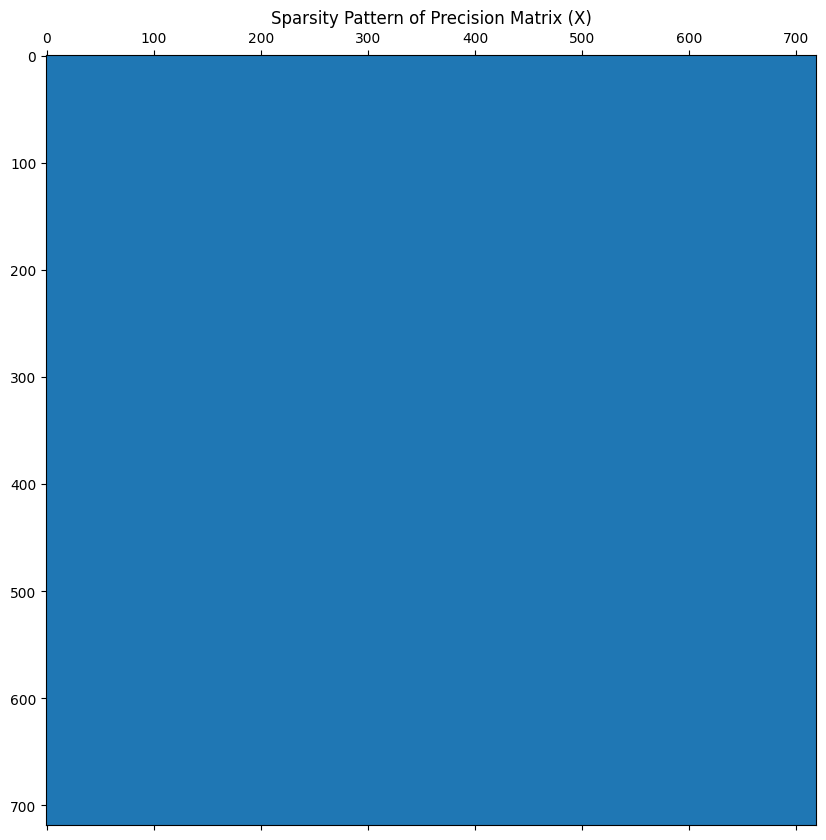

In [56]:
sparsity_pattern(X_w)

## Squic GMB

In [57]:
X_gmb = compute_squic(df_gmb, l)

----------------------------------------------------------------
                     SQUIC Version 1.0                         
----------------------------------------------------------------
Input Matrices
 nnz(X0)/p:   1.000000e+00
 nnz(W0)/p:   1.000000e+00
 nnz(M)/p:    ignored
 Y:           719 x 8032 
Runtime Configs   
 Sample Cov.:   Deterministic
 CordDec Vers:  Collective coordinate descent update 
 Inversion:     Approx. block Neumann series
 Fact. Routine: CHOLMOD
Parameters       
 verbose:     1 
 lambda:      1.000000e-03 
 max_iter:    100 
 term_tol:    1.000000e-03 
 inv_tol:     1.000000e-04 
 threads:     12 

#SQUIC Started 
* sample covariance matrix S: time=5.79e-02 nnz(S)/p=6.70e+01
* iter=1 time=1.11e-02 obj=-4.73e+02 |delta(obj)|/obj=1.02e+00 nnz(X,L,W)/p=[6.70e+01 1.25e+02 1.00e+00] lns_iter=1 
* iter=2 time=1.89e-02 obj=-9.42e+02 |delta(obj)|/obj=4.98e-01 nnz(X,L,W)/p=[6.70e+01 1.25e+02 7.70e+00] lns_iter=1 
* iter=3 time=7.17e-02 obj=-1.39e+03 |delta(obj)

In [58]:
count_zero(X_gmb)

Number of nonzero elements: 29093
Sparsity level: 0.0563


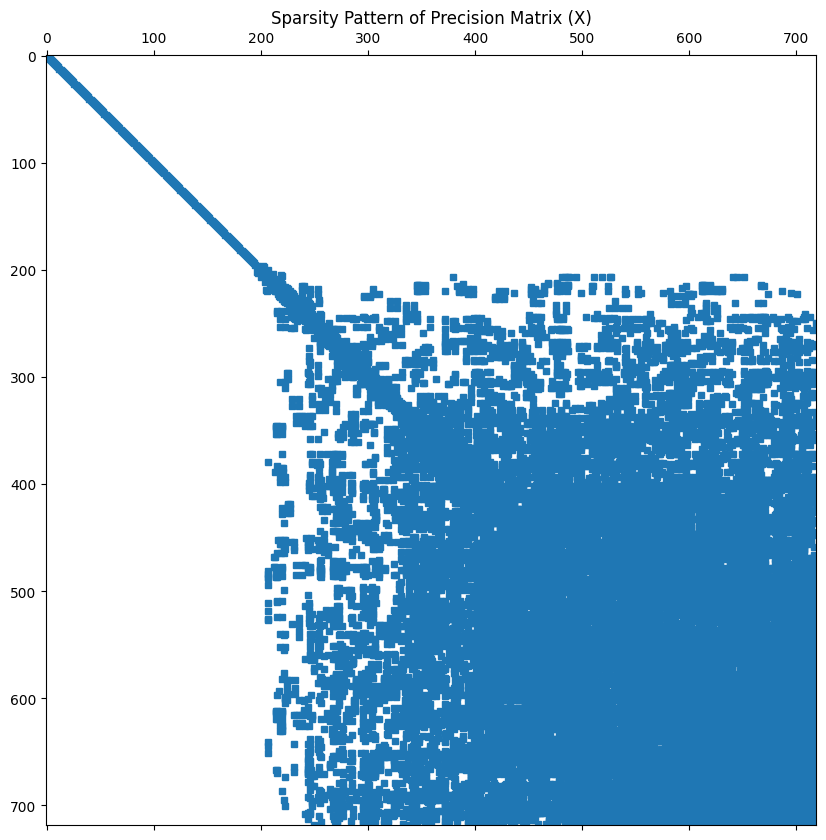

In [59]:
sparsity_pattern(X_gmb)